In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
#%matplotlib inline
import warnings
import statsmodels.api as sm
import plotly.express as px
import seaborn as sns

In [2]:
#define working directory
os.chdir("E:/Kurs/Data Glacier/DataSets-main")

In [3]:
# read and merge datasets
df1 = pd.read_csv('Cab_Data.csv')
df2 = pd.read_csv('City.csv')
df3 = pd.read_csv('Transaction_ID.csv')
df4 = pd.read_csv('Customer_ID.csv')

merged_df = pd.merge(df1, df2, on='City', how='outer')
merged_df = pd.merge(merged_df, df3, on='Transaction ID', how='outer')
merged_df = pd.merge(merged_df, df4, on='Customer ID', how='outer')

# write the merged dataframe to a new CSV file
merged_df.to_csv('merged_file.csv', index=False)

In [4]:
df = merged_df

In [5]:
df = pd.read_csv('merged_file.csv', dtype={'City': 'string', 'Company': 'string'})
df = df.dropna()

In [6]:
#top five obs
df.head()

,Transaction ID,Date of Travel,Company,City,KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,Payment_Mode,Gender,Age,IncomePerMonth
0,10000011.0,42377.0,Pink Cab,ATLANTA GA,30.45,370.95,313.6350,814885.0,24701.0,29290.0,Card,Male,28.0,10813.0
1,10351127.0,43302.0,Yellow Cab,ATLANTA GA,26.19,598.70,317.4228,814885.0,24701.0,29290.0,Cash,Male,28.0,10813.0
2,10412921.0,43427.0,Yellow Cab,ATLANTA GA,42.55,792.05,597.4020,814885.0,24701.0,29290.0,Card,Male,28.0,10813.0
3,10000012.0,42375.0,Pink Cab,ATLANTA GA,28.62,358.52,334.8540,814885.0,24701.0,27703.0,Card,Male,27.0,9237.0
4,10320494.0,43211.0,Yellow Cab,ATLANTA GA,36.38,721.10,467.1192,814885.0,24701.0,27703.0,Card,Male,27.0,9237.0


In [7]:
#data info
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 359392 entries, 0 to 359890
Data columns (total 14 columns):
 #   Column          Non-Null Count   Dtype  
---  ------          --------------   -----  
 0   Transaction ID  359392 non-null  float64
 1   Date of Travel  359392 non-null  float64
 2   Company         359392 non-null  string 
 3   City            359392 non-null  string 
 4   KM Travelled    359392 non-null  float64
 5   Price Charged   359392 non-null  float64
 6   Cost of Trip    359392 non-null  float64
 7   Population      359392 non-null  float64
 8   Users           359392 non-null  float64
 9   Customer ID     359392 non-null  float64
 10  Payment_Mode    359392 non-null  object 
 11  Gender          359392 non-null  object 
 12  Age             359392 non-null  float64
 13  IncomePerMonth  359392 non-null  float64
dtypes: float64(10), object(2), string(2)
memory usage: 41.1+ MB


In [8]:
df = df.drop_duplicates()

In [9]:
#shape of the data
df.shape

(359392, 14)

In [10]:
#summary statistics
df.describe()

,Transaction ID,Date of Travel,KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,Age,IncomePerMonth
count,3.593920e+05,359392.000000,359392.000000,359392.000000,359392.000000,3.593920e+05,359392.000000,359392.000000,359392.000000,359392.000000
mean,1.022076e+07,42964.067998,22.567254,423.443311,286.190113,3.132198e+06,158365.582267,19191.652115,35.336705,15048.822937
std,1.268058e+05,307.467197,12.233526,274.378911,157.993661,3.315194e+06,100850.051020,21012.412463,12.594234,7969.409482
min,1.000001e+07,42371.000000,1.900000,15.600000,19.000000,2.489680e+05,3643.000000,1.000000,18.000000,2000.000000
25%,1.011081e+07,42697.000000,12.000000,206.437500,151.200000,6.712380e+05,80021.000000,2705.000000,25.000000,8424.000000
50%,1.022104e+07,42988.000000,22.440000,386.360000,282.480000,1.595037e+06,144132.000000,7459.000000,33.000000,14685.000000
75%,1.033094e+07,43232.000000,32.960000,583.660000,413.683200,8.405837e+06,302149.000000,36078.000000,42.000000,21035.000000
max,1.044011e+07,43465.000000,48.000000,2048.030000,691.200000,8.405837e+06,302149.000000,60000.000000,65.000000,35000.000000


In [11]:
#Correlation Matrix ( High Correlation KM Travelled vs Cost of Trip also Age vs IncomePerMonth )
df.corr()

,Transaction ID,Date of Travel,KM Travelled,Price Charged,Cost of Trip,Population,Users,Customer ID,Age,IncomePerMonth
Transaction ID,1.000000,0.993030,-0.001429,-0.052902,-0.003462,0.023868,0.013526,-0.016912,-0.001267,-0.001570
Date of Travel,0.993030,1.000000,-0.001621,-0.055559,-0.004484,0.022102,0.011780,-0.017653,-0.001346,-0.001368
KM Travelled,-0.001429,-0.001621,1.000000,0.835753,0.981848,-0.002311,-0.000428,0.000389,-0.000369,-0.000544
Price Charged,-0.052902,-0.055559,0.835753,1.000000,0.859812,0.326589,0.281061,-0.177324,-0.003084,0.003228
Cost of Trip,-0.003462,-0.004484,0.981848,0.859812,1.000000,0.015108,0.023628,0.003077,-0.000189,-0.000633
Population,0.023868,0.022102,-0.002311,0.326589,0.015108,1.000000,0.915490,-0.647052,-0.009002,0.011868
Users,0.013526,0.011780,-0.000428,0.281061,0.023628,0.915490,1.000000,-0.610742,-0.005906,0.010464
Customer ID,-0.016912,-0.017653,0.000389,-0.177324,0.003077,-0.647052,-0.610742,1.000000,-0.004735,-0.013608
Age,-0.001267,-0.001346,-0.000369,-0.003084,-0.000189,-0.009002,-0.005906,-0.004735,1.000000,0.003907
IncomePerMonth,-0.001570,-0.001368,-0.000544,0.003228,-0.000633,0.011868,0.010464,-0.013608,0.003907,1.000000


Text(0, 0.5, 'Cost of Trip')

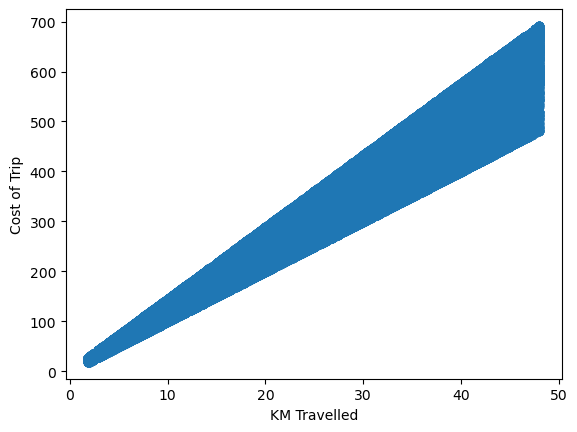

In [12]:
#Plot confirming high correlation between columns indicated
plt.scatter(df["KM Travelled"], df["Cost of Trip"])
plt.xlabel("KM Travelled")
plt.ylabel("Cost of Trip")

In [13]:
df.rename(columns={'Cost of Trip': 'Cost_of_Trip'}, inplace=True)
df.rename(columns={'Date of Travel': 'Date_of_Travel'}, inplace=True)

Text(0, 0.5, 'Cost_of_Trip')

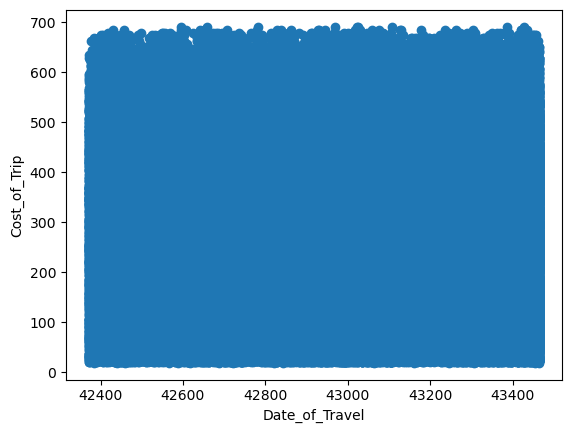

In [14]:
#Plot confirming high correlation between columns indicated (Indetified as related)
plt.scatter(df["Date_of_Travel"], df["Cost_of_Trip"])
plt.xlabel("Date_of_Travel")
plt.ylabel("Cost_of_Trip")

Text(0, 0.5, 'IncomePerMonth')

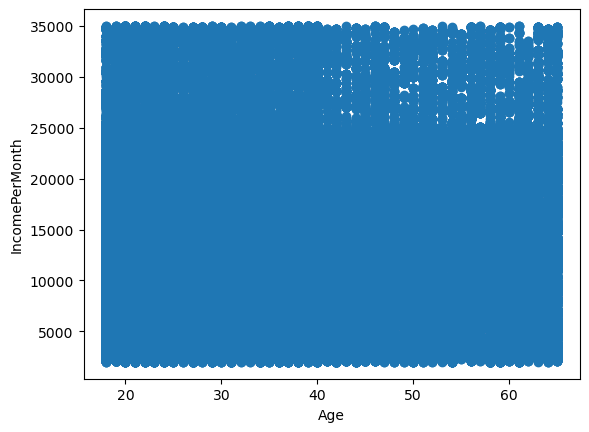

In [15]:
#Plot confirming correlation between columns indicated (Indetified as related)
plt.scatter(df["Age"], df["IncomePerMonth"])
plt.xlabel("Age")
plt.ylabel("IncomePerMonth")

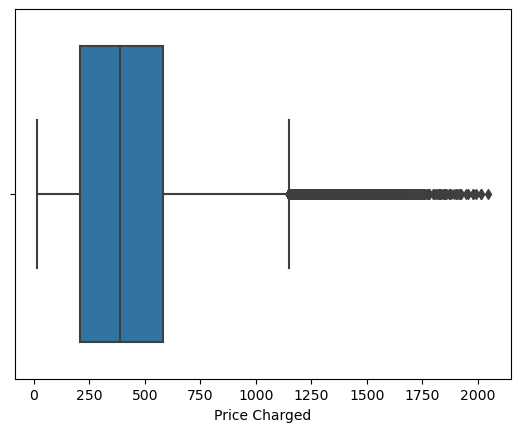

In [16]:
# Boxplot for column identified with outliers ( Dropped as Irrelevant in my research)
sns.boxplot(x=df["Price Charged"])
df = df.drop('Price Charged', axis=1)

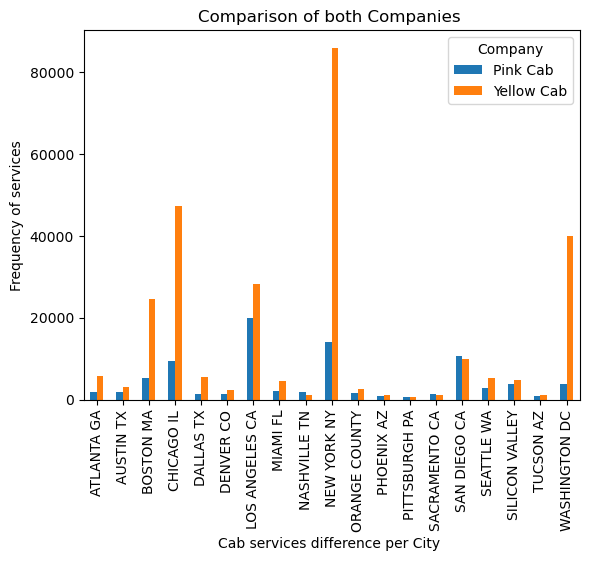

In [17]:
#Which company its used mostly in each city ?
# Tab plot showing domination of Yellow Cab over Pink Cab per City
freq_table = pd.crosstab(df.City, df.Company)
freq_table.plot(kind='bar')
plt.title('Comparison of both Companies ')
plt.xlabel('Cab services difference per City ')
plt.ylabel('Frequency of services')
plt.show()

In [27]:
#Is services provided same in each Company ?
#Histogram (Yellow Cab overwheelming Pink Cab in amount of service)
fig = px.histogram(df, x="Company",)
fig.show()

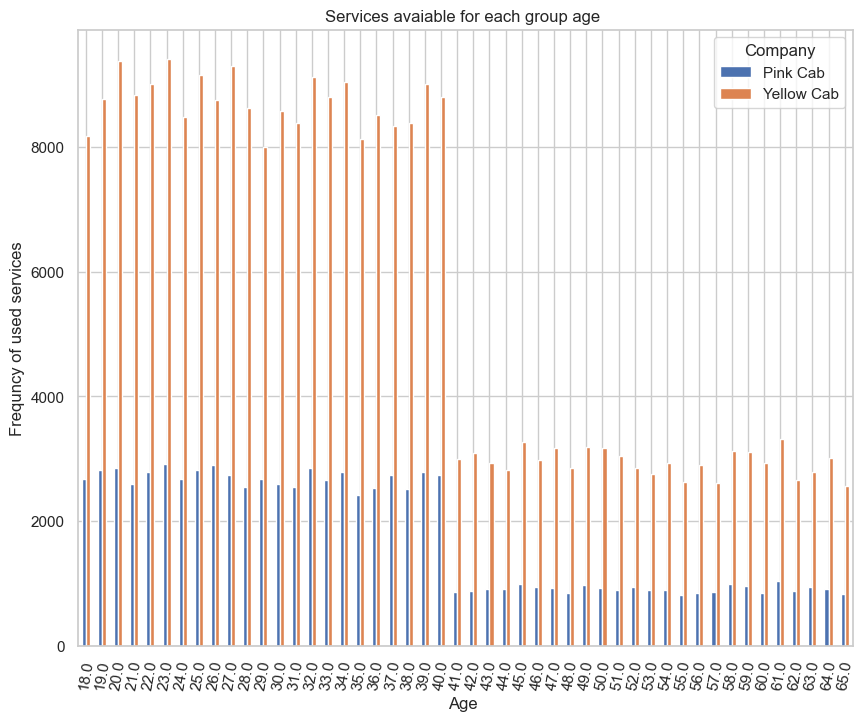

In [31]:
#In which group age the service of Cabs are used mostly ?
#Indentified age between 18-40 for the group of age uses Cabs mostly.
freq_table = pd.crosstab(df.Age, df.Company)
freq_table.plot(kind='bar', rot=80, figsize=(10,8))
plt.title('Services avaiable for each group age ')
plt.xlabel('Age ')
plt.ylabel('Frequncy of used services')
plt.xticks
plt.show()

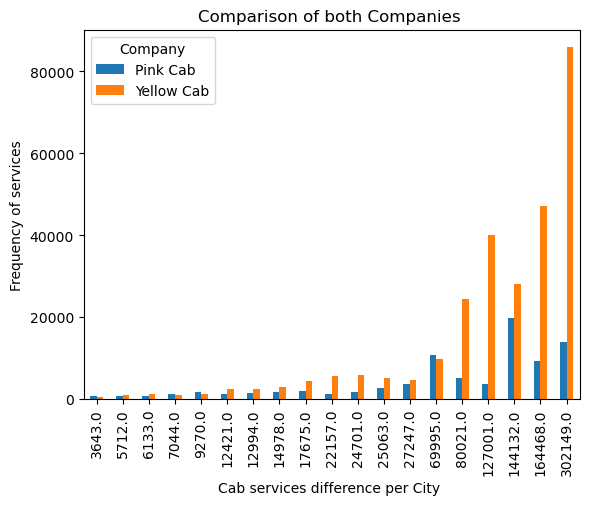

In [20]:
#Does Yellow Cab per Users its also higher then Pink Cab ?
# Tab plot showing again domination of Yellow Cab over Pink Cab per Users
freq_table = pd.crosstab(df.Users, df.Company)
freq_table.plot(kind='bar')
plt.title('Comparison of both Companies ')
plt.xlabel('Users ')
plt.ylabel('Frequency of Users')
plt.show()

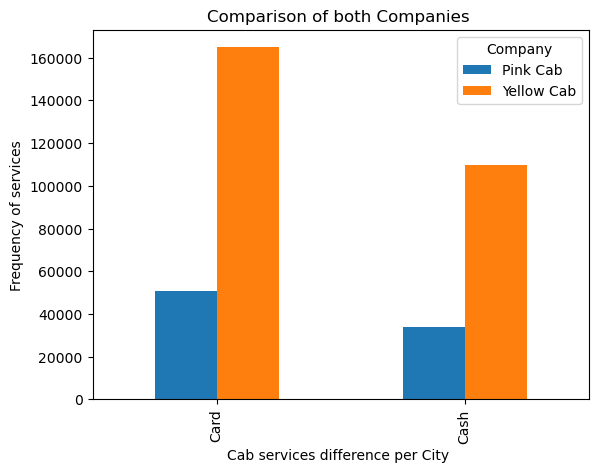

In [21]:
#Is Card payment more popular then cash payment ?
#As we can see card payment option its a lot more needed then cash.
freq_table = pd.crosstab(df.Payment_Mode, df.Company)
freq_table.plot(kind='bar')
plt.title('Comparison of both Companies ')
plt.xlabel('Cab services difference per City ')
plt.ylabel('Frequency of services')
plt.show()

In [22]:
#Confirmation of Card payments more popular the cash in general
fig = px.histogram(df, x="Payment_Mode",)
fig.show()

In [24]:
#1.As we can see in every type of analysis which we performed Yellow Cab has a lot bigger frequency of services,
#in most of the cities and over all Yellow Cab has a lot more preference choosen by people.
#2.Also Yellow Cab is used by different age group and its a lot more used then Pink Cab.
#3.Yellow Cab has a lot more profit compare to Pink Cab.
#4.A lot more users of Yellow Cab Then Pink Cab.
#5.Pink Cab problem mite be in lack of card payment method availability.
#6.Please check README on github.